# Inject Interpolated Embeddings
In this notebook first experiments to inject modified CLIP embedings back to the stable diffusion pipeline are conducted

In [1]:
import torch
import numpy as np
from PIL import Image
from tqdm.auto import tqdm
from transformers import CLIPTextModel, CLIPTokenizer
from diffusers import AutoencoderKL, UNet2DConditionModel, PNDMScheduler
from diffusers.image_processor import VaeImageProcessor
from utils.model import VAE

In [2]:
#load components
vae_m = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae", use_safetensors=True)
tokenizer = CLIPTokenizer.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="tokenizer")
text_encoder = CLIPTextModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="text_encoder", use_safetensors=True)
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet", use_safetensors=True)
scheduler = PNDMScheduler.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="scheduler")

In [3]:
# move to GPU
device = "cuda"
text_encoder.to(device)
vae_m.to(device)
unet.to(device)
""

''

In [4]:
# config

#prompt = ["a picture of a red car", 'a picture of a blue car']
#prompt = ["a photo of a dog", "a photo of a cat"]
prompt = ["a photo of a landscape in winter","a photo of a landscape in fall"]
#prompt = ["A photo of a monkey", "A photo of a man"]

height = 512
width = 512
num_inference_steps = 25
guidance_scale = 7.5

In [5]:
# generate text tokens and embeddings 
text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors='pt')
with torch.no_grad():
    text_embeddings = text_encoder(text_input.input_ids.to(device))[0]

In [6]:
def interp(x, y, steps):
    res = torch.ones([steps+1,77,768])
    for d0 in tqdm(range(len(x))): 
        for d1 in range(len(x[d0])):
            step =  (y[d0][d1] - x[d0][d1]) / steps
            for s in range(steps+1):
                res[s][d0][d1] = x[d0][d1] + step*s 
    return res

In [7]:
def interp_gpu(x, y, steps):
    # Expand dimensions to match the target shape
    x = x.unsqueeze(0).unsqueeze(0)
    y = y.unsqueeze(0).unsqueeze(0)

    # Create a linear space tensor for steps
    s_values = torch.linspace(0, 1, steps, device='cuda')

    # Expand dimensions to allow broadcasting
    s_values = s_values.unsqueeze(0).unsqueeze(2).unsqueeze(3)

    # Calculate the entire interpolation in a single operation
    res = x + (y - x) * s_values

    return res.squeeze(0).squeeze(0)

In [8]:
#%%timeit -r 5 -n 10
text_embeddings_int = interp_gpu(text_embeddings[0], text_embeddings[1], 50).to(device)
text_embeddings_int.shape

torch.Size([50, 77, 768])

In [9]:
# empty embeddings used for classifier free guidance
batch_size = len(text_embeddings_int)
max_length = text_input.input_ids.shape[-1]
uncond_input = tokenizer([""] * batch_size, padding="max_length", max_length=max_length, return_tensors="pt")
uncond_embeddings = text_encoder(uncond_input.input_ids.to(device))[0]
text_embeddings_cfg = torch.cat([uncond_embeddings, text_embeddings_int])
text_embeddings_int.shape

torch.Size([50, 77, 768])

In [10]:
text_embeddings_cfg.shape

torch.Size([100, 77, 768])

In [11]:
# initialize latent variables
from utils.vector import getNoise
latents = getNoise(batch_size)
latents = latents.to(device)
latents.shape

torch.Size([50, 4, 64, 64])

In [12]:
latents = latents * scheduler.init_noise_sigma

In [13]:
latents.shape

torch.Size([50, 4, 64, 64])

In [14]:
# generate
from tqdm.auto import tqdm

scheduler.set_timesteps(num_inference_steps)

for t in tqdm(scheduler.timesteps):
    latent_model_input = torch.cat([latents] *2)
    latent_model_input = scheduler.scale_model_input(latent_model_input, timestep=t)

    with torch.no_grad():
        noise_pred = unet(latent_model_input, t, encoder_hidden_states=text_embeddings_cfg).sample

    noise_pred_uncond, noise_pred_text =noise_pred.chunk(2)
    noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

    latents = scheduler.step(noise_pred, t, latents).prev_sample

  0%|          | 0/26 [00:00<?, ?it/s]

In [15]:
vae = VAE()
out = vae.d(latents)

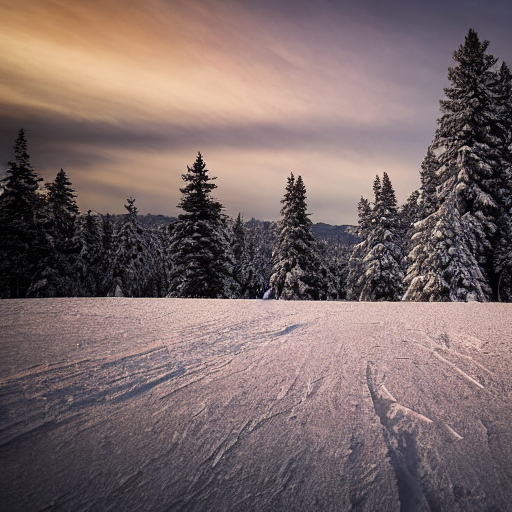

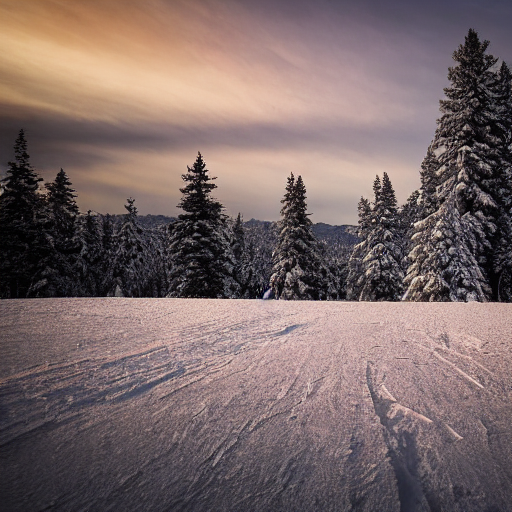

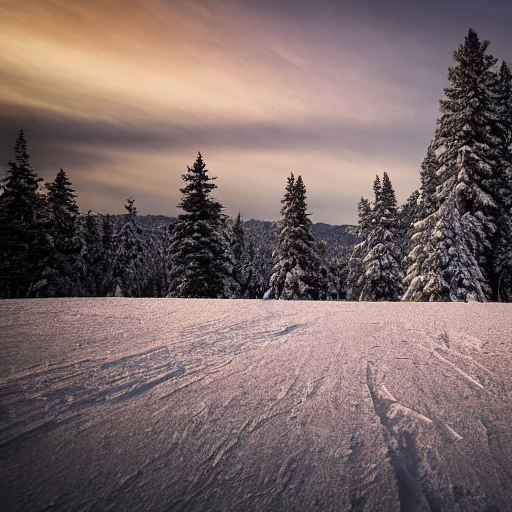

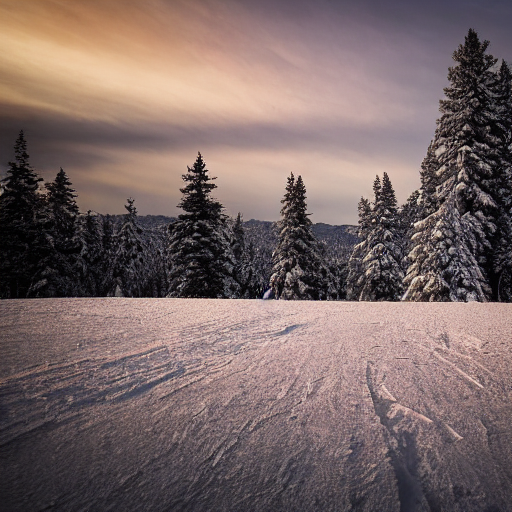

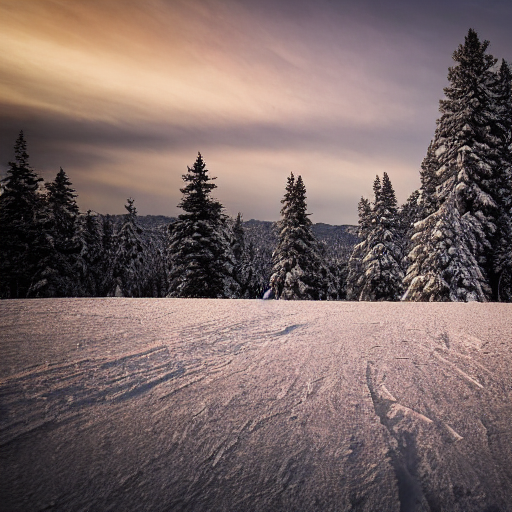

...

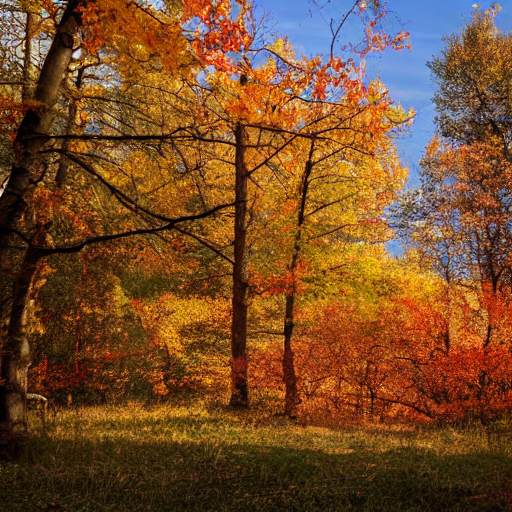

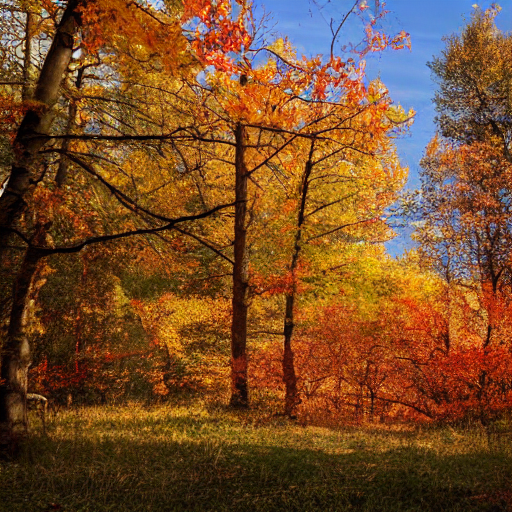

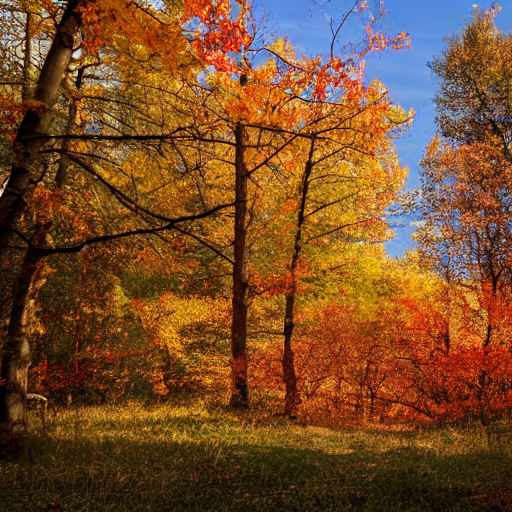

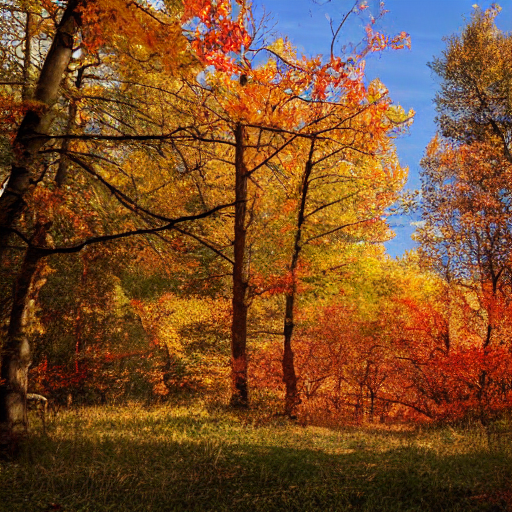

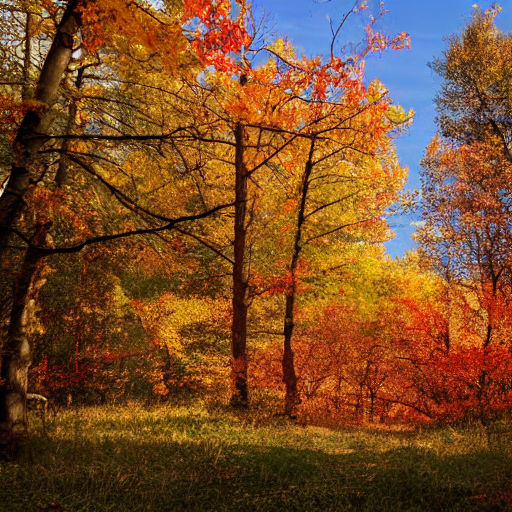

In [16]:
for o in out:
    display(o)

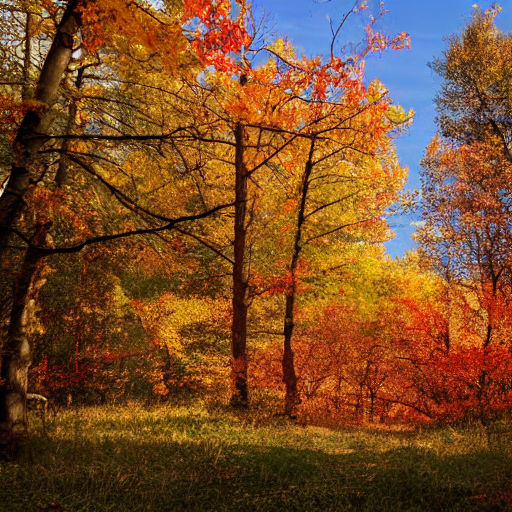

In [17]:
from utils.show import flipbook 
flipbook(out,0.2)

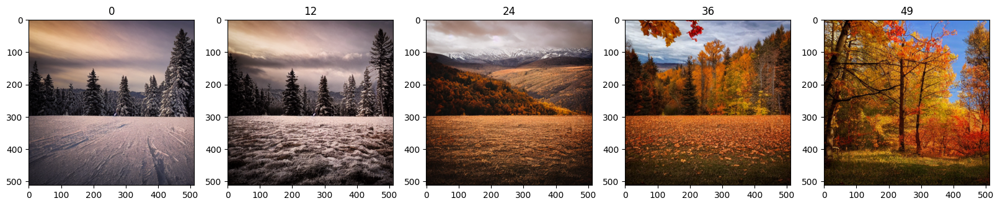

In [18]:
from utils.show import grid
grid(out)